**Hinweis:** Die Werte können leicht von den in der Thesis präsentierten Werten abweichen, da dieses Notebook im Nachhinein nochmals ausgeführt worden ist.

---

### Inhaltsverzeichnis

* [1. Packete Impotieren](#import_packages)
* [2. Daten einlesen](#read_data)
* [3. Helper Methods](#helper_methods)
* [4. Classifier Comparer Class](#clf_comparer)
* [5. Klassifikatoren](#clfs)
* [6. Experimente](#exp)
    * [6.1. Experiment 1: Demographic Features](#exp1)
    * [6.2. Experiment 2: VLE Interaction Features](#exp2)
    * [6.3. Experiment 3: Assessment Features](#exp3)
    * [6.4. Experiment 4: All Features](#exp4)
* [7. Optimierung](#opt)

## 1. Packete impotieren <a class="anchor" id="import_packages"></a>

In [1]:
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import ConfusionMatrixDisplay, accuracy_score, recall_score, precision_score, f1_score, confusion_matrix, classification_report
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.dummy import DummyClassifier
from sklearn.model_selection import cross_val_score, KFold

import seaborn as sns

from mpl_toolkits.axes_grid1 import make_axes_locatable

import glob
import math
import copy
from tqdm import tqdm

In [2]:
# Font Size
font = {'size'   : 26}
matplotlib.rc('font', **font)

# Reset
def resetMatplotLib():
    matplotlib.rc_file_defaults()
    matplotlib.rc('font', **font)

## 2. Daten einlesen <a class="anchor" id="read_data"></a>

In [3]:
path = './../CSVs/encodedCSVs' # use your path
all_files = sorted(glob.glob(path + "/*.csv"))

dataframes = []

for filename in all_files:
    df = pd.read_csv(filename, index_col=None, header=0)
    
    dataframes.append(df)

In [4]:
demographic_features = ['M', 'Y', 'highest_education', 'imd_band', 'age_band', 'final_result', 'East Anglian Region',
                       'East Midlands Region', 'Ireland', 'London Region', 'North Region', 'North Western Region',
                       'Scotland', 'South East Region', 'South Region', 'South West Region', 'Wales',
                        'West Midlands Region', 'Yorkshire Region']

vle_features = ['dataplusSum', 'dualpaneSum', 'externalquizSum', 'forumngSum', 'glossarySum', 'homepageSum', 
                'htmlactivitySum', 'oucollaborateSum', 'oucontentSum', 'ouelluminateSum', 'ouwikiSum', 'pageSum',
                'questionnaireSum', 'quizSum', 'resourceSum', 'sharedsubpageSum', 'subpageSum', 'urlSum',
                'final_result']

vle_interactions_features = ['dataplusClicks', 'dualpaneClicks', 'externalquizClicks', 'forumngClicks', 'glossaryClicks',
                            'homepageClicks', 'htmlactivityClicks', 'oucollaborateClicks', 'oucontentClicks', 
                             'ouelluminateClicks', 'ouwikiClicks', 'pageClicks', 'questionnaireClicks', 'quizClicks',
                            'resourceClicks', 'sharedsubpageClicks', 'subpageClicks', 'urlClicks', 'vle_access_date_mean',
                            'final_result']

assessments_features = ['weightedScore', 'scoreMean', 'final_result']

## 3. Helper Methods <a class="anchor" id="helper_methods"></a>

**reduceYLables:** <br>
Nimmt einen Dataframe entgegen und die Anzahl an Klassen, die das Zielmerkmal des zurückgegebenen Datensatz besitzen soll. Zudem können die Labels zurückgegeben werden.

<img src="img/classesCount.png" alt="Classes"/>

In [5]:
def reduceYLables(df_org, classesCount, getLabels = False):
    df_copy = copy.deepcopy(df_org)
    
    if classesCount == 4:
        labels = ['Distinction', 'Pass', 'Fail', 'Withdrawn']
    
    elif classesCount == 3:
        classDict = { 'Distinction': 'Pass', 'Pass': 'Pass', 'Withdrawn': 'Withdrawn', 'Fail': 'Fail' }
        df_copy['final_result'] = df_copy['final_result'].apply(lambda x: classDict[x])
        labels = ['Pass', 'Fail', 'Withdrawn']

    else:
        classDict = { 'Distinction': 'Pass', 'Pass': 'Pass', 'Withdrawn': 'Fail', 'Fail': 'Fail' }
        df_copy['final_result'] = df_copy['final_result'].apply(lambda x: classDict[x])
        labels = ['Pass', 'Fail']
    
    if getLabels:
        return df_copy, labels
        
    else:
        return df_copy

**getDFsWithSubFeatures:** <br>
Übergeben wird ein Datensatz und die Merkmale, die der zurückgegebene Datensatz besitzen soll.

In [6]:
def getDFsWithSubFeatures(dfs, features):
    subfeatures_dataframes = []

    for df in dfs:
        subFeaturesDF = df.drop(labels=df.columns.difference(features), axis=1, inplace=False)
        subfeatures_dataframes.append(subFeaturesDF)
        
    return subfeatures_dataframes

**crossValidate:** <br>
Führt eine 10-Fache Kreuzvalidierung mit dem übergebenen Datensatz und Klassifikator durch.

In [7]:
def crossValidate(df, clf):
    crossValidateDF = df.select_dtypes(include=np.number)
    crossValidateX = crossValidateDF.values
    crossValidateY = df['final_result']
        
    cv = KFold(n_splits=10, random_state=1, shuffle=True)
        
    scores = cross_val_score(clf, crossValidateX, crossValidateY, cv=cv)
        
    print(type(clf).__name__, ": ", round(scores.mean(), 3), round(scores.std(), 3))
    print(scores)

**splitData:** <br>
Teilt den Datensatz in Trainings und Testdaten auf und skaliert diese.

In [8]:
def splitData(df):
    # Splitting in x und y
    numericDF = df.select_dtypes(include=np.number)
    X = numericDF.values
    y = df['final_result']
        
    X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=8)
            
    X_train = sc.fit_transform(X_train)
    X_test = sc.fit_transform(X_test)
    
    return X_train, X_test, y_train, y_test

**plotFeatureImportance:** <br>
Plottet die Wichtigkeit der *n* wichtigsten Merkmale. Es muss der Datensatz angegeben werden, mit dem die Klassifiaktion durchgeführt werden soll, wie auch der Klassifikator, der für die Klassifikation verwendet wird. Zudem kann die Zahl *n* (Standartwert = 10) angegeben werden.

In [9]:
def plotFeatureImportance(df, clf, n = 10):
    numericDF = df.select_dtypes(include=np.number)
    X_train, X_test, y_train, y_test = splitData(df)
    
    clf.fit(X_train, y_train)
    
    plt.figure(figsize=(14, 6), dpi=200)
    plt.xticks(rotation=90)

    plt.title("Wichtigkeit der Eingabemerkmale")
    plt.xlabel("Eingabemerkmale", labelpad=20)
    plt.ylabel("Wichtigkeit")
    
    plt.xticks(rotation=45, ha='right')

    keys = numericDF.keys()
    sorted_idx = clf.feature_importances_.argsort()[::-1][:n]

    plt.bar(keys[sorted_idx], clf.feature_importances_[sorted_idx],  color=('#030c7e'))
    plt.show()

**plotCm:** <br>
Plottet die Confusion Matrix einer Klassifikation. Es muss der Datensatz angegeben werden, mit dem die Klassifiaktion durchgeführt werden soll, wie auch der Klassifikator, der für die Klassifikation verwendet wird. Zudem kann Angegeben werden ob die Werte normalisiert werden sollen.

In [10]:
def plotCm(df, clf, labels, normalize = None):
    X_train, X_test, y_train, y_test = splitData(df)
    clf.fit(X_train, y_train)

    y_pred = clf.predict(X_test)
    
    # Plot
    fig, ax = plt.subplots(figsize=(10, 10), dpi=250)

    # Font Size
    label_font = {'size':'22'}
    ax.set_xlabel("Predicted label", fontdict = label_font);
    ax.set_ylabel("True label", fontdict = label_font);
    ax.tick_params(axis='both', which='major', labelsize=22)

    disp = ConfusionMatrixDisplay.from_predictions(y_test,
                                                   y_pred,
                                                   labels=labels,
                                                   ax=ax,
                                                   cmap='Blues',
                                                   normalize=normalize)

    # Alte Colorbar löschen
    disp.ax_.images[-1].colorbar.remove()

    # Colorbar Größe anpassen
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    fig.colorbar(disp.im_, cax=cax)

    plt.show()

**predictWithClfs:** <br>
Führt jeweils für jeden angegeben Klassifikator eine 10-Fache Kreuzvalidierung mit dem übergebenen Datensatz durch.

In [11]:
def predictWithClfs(df, clfs):
    # Splitting in x und y
    numericDF = df.select_dtypes(include=np.number)
    X = sc.fit_transform(numericDF.values)
    y = df['final_result']
    
    for clf in clfs:
        cv = KFold(n_splits=10, random_state=1, shuffle=True)
        scores = cross_val_score(clf, X, y, cv=cv)
        
        print(type(clf).__name__, ": ", round(scores.mean(), 3), round(scores.std(), 3))
        print(scores, "\n")
    
    print("Null Accuracy: ", round(y.value_counts().head(1).values[0] / len(y), 3))

    plt.show()

## 4. Classifier Comparer Class <a class="anchor" id="clf_comparer"></a>

Hierbei handelt es sich um eine Klasse um mehrere Klassifikatoren über die Laufzeit eines Kurses miteinander zu vergleichen.

In [12]:
class ClfComparer:
    
    def __init__(self, dataframes, classifiers):
        self.dataframes = dataframes
        self.classifiers = classifiers
        self.classifierNames = []
        
        for clf in classifiers:
            try:
                self.classifierNames.append(str(type(clf).__name__) + ' (' + str(clf.kernel) +')')

            except:
                self.classifierNames.append(str(type(clf).__name__))
                
        # Null Accuracy
        self.classifierNames.append("Null Accuracy")
        self.nullAccuracy = list(range(0, 101))
        
        self.sc = StandardScaler()
        self.classes = []
        self.y = list(range(0, 101))
        
        self.classDict = []
        
        self.accResults = []
        self.f1Results = []
        self.failedPasses = []
        self.failedFails = []
        
    
    def compareClassifiers(self, numClasses):
        
        # Results zurücksetzten
        self.accResults = [[0] * 101 for i in range(len(self.classifiers))]
        self.f1Results = [[0] * 101 for i in range(len(self.classifiers))]
        self.failedPasses = [[0] * 101 for i in range(len(self.classifiers))]
        self.failedFails = [[0] * 101 for i in range(len(self.classifiers))]
        
        # Target Names Updaten
        if(numClasses == 4):
            self.classes = ['Distinction', 'Pass', 'Withdrawn', 'Fail']
            
        elif(numClasses == 3):
            self.classes = ['Pass', 'Withdrawn', 'Fail']
                
        elif(numClasses == 2):
            self.classes = ['Pass', 'Fail']
                        
        else:
            print("Die übergebene Zahl muss zwischen 2 und 4 sein.")
            
        self.calculateAccuracy()
            
            
    def splitScaleData(self, df):
        # Splitting in x und y
        numericDF = df.select_dtypes(include=np.number)
        
        X = numericDF.values
        
        if len(self.classes) == 4:
            self.classDict = { 'Distinction': 0, 'Pass': 1, 'Withdrawn': 2, 'Fail': 3 }
            y = df['final_result'].apply(lambda x: self.classDict[x])
            
        elif(len(self.classes) == 3):
            self.classDict = { 'Distinction': 0, 'Pass': 0, 'Withdrawn': 1, 'Fail': 2 }
            y = df['final_result'].apply(lambda x: self.classDict[x])
            
        else:
            self.classDict = { 'Distinction': 0, 'Pass': 0, 'Withdrawn': 1, 'Fail': 1 }
            y = df['final_result'].apply(lambda x: self.classDict[x])
        
        # Splitting in Trainings und Test Daten
        X_train, X_test, y_train, y_test = train_test_split(X, y)

        self.sc.fit(X_train, y_train)

        X_train = self.sc.transform(X_train)
        X_test = self.sc.transform(X_test)

        return X_train, X_test, y_train, y_test
    
    
    def calculateAccuracy(self):
        
        # 100% durchgehen
        for percentage in tqdm(range(101)):
            df = self.dataframes[percentage]
        
            # Splitted Data
            X_train, X_test, y_train, y_test = self.splitScaleData(df)
            
            # Null Accuracy
            self.nullAccuracy[percentage] = round(y_test.value_counts().head(1).values[0] / len(y_test), 3)

            # Test
            for clfIdx in range(len(self.classifiers)):
                self.classifiers[clfIdx].fit(X_train, y_train)

                y_pred = self.classifiers[clfIdx].predict(X_test)
                
                # Metrics
                acc = accuracy_score(y_test, y_pred)
                f1score = f1_score(y_test, y_pred, average='weighted')

                self.accResults[clfIdx][percentage] = acc
                self.f1Results[clfIdx][percentage] = f1score
                
                cm = confusion_matrix(y_test, y_pred)
                
                plt.show()
                
                if len(self.classes) == 4:
                    self.failedPasses[clfIdx][percentage] = np.sum(np.delete(np.delete(cm, [0, 1], 0), [2, 3], 1))
                    self.failedFails[clfIdx][percentage] = np.sum(np.delete(np.delete(cm, [2, 3], 0), [0, 1], 1))
                    
                elif len(self.classes) == 3:
                    self.failedPasses[clfIdx][percentage] = np.sum(np.delete(np.delete(cm, 0, 0), [1, 2], 1))
                    self.failedFails[clfIdx][percentage] = np.sum(np.delete(np.delete(cm, [1, 2], 0), 0, 1))
                    
                else:
                    self.failedPasses[clfIdx][percentage] = np.sum(np.delete(np.delete(cm, 0, 0), 1, 1))
                    self.failedFails[clfIdx][percentage] = np.sum(np.delete(np.delete(cm, 1, 0), 0, 1))
                    
        
    def plotResults(self):
        
        metrics = [self.accResults, self.f1Results, self.failedPasses, self.failedFails]
        
        if len(self.classes) == 4:
            passPredictedButFailedLabel = 'False Positives\nPredicted: Distinction & Pass\nTrue: Withdrawn & Fail'
            failPredictedButPassLabel = 'False Negatives\nPredicted: Withdrawn & Fail\nTrue: Distinction & Pass'
            
        elif len(self.classes) == 3:
            passPredictedButFailedLabel = 'False Positives\nPredicted: Pass\nTrue: Withdrawn & Fail'
            failPredictedButPassLabel = 'False Negatives\nPredicted: Withdrawn & Fail\nTrue: Pass'
            
        else:
            passPredictedButFailedLabel = 'False Positives\nPredicted: Pass\nTrue: Fail'
            failPredictedButPassLabel = 'False Negatives\nPredicted: Fail\nTrue: Pass'
            
        metricsTitles = ['Accuracy Vergleich', 'F1 Score Vergleich', passPredictedButFailedLabel, failPredictedButPassLabel]
        metricsLables = ['Accuracy', 'F1 Score', 'Anzahl', 'Anzahl']
        
        # Plot
        fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(26,18), dpi=333)
        fig.subplots_adjust(hspace=0.5)
        
        col = 0
        row = 0
        
        for metricIdx in range(len(metrics)):
            for idx in range(len(metrics[metricIdx])):
                axes[col][row].plot(self.y, metrics[metricIdx][idx], label=self.classifierNames[idx], linewidth=4)
                
            # Subplot Titel
            axes[col][row].set_title(metricsTitles[metricIdx], fontsize=26)
            
            # Subplot x / y lables
            axes[col][row].set_xlabel('Vergangene Zeit (%)')
            axes[col][row].set_ylabel(metricsLables[metricIdx])
            
            row += 1
            
            if row > 1:
                row = 0
                col += 1
                
        # Null Accuracy nur bei Accuracy
        axes[0][0].plot(self.y, self.nullAccuracy, label="Null Accuracy", color='black', linestyle='dashed', linewidth=4)
        
        # Legende
        handles, labels = axes[0][0].get_legend_handles_labels()
        
        cols = math.ceil((len(self.classifiers) + 1) / 2)
            
        leg = plt.legend(handles = handles,
                   labels = labels,
                   title = "Algorithmen",
                   bbox_to_anchor = (0.2666 * cols, -0.2),
                   ncol = cols)
        
        leg.get_frame().set_linewidth(0.0)
        
        plt.show()

## 5. Klassifikatoren <a class="anchor" id="clfs"></a>

Es werden fünf Klassifikatoren ausgewählt, die miteinander verglichen werden sollen. Für alle Klassifikatoren wurden die Standard Hyperparameter verwendet. Allein für den KNN-Klassifikator muss *k* bestimmt werden. Wie zu erkennen, verbessert sich die Accuracy bei einer 10-Fachen Kreuzvalidierung nicht mehr ab *k = 19*.

In [13]:
kValues = [1, 3, 7, 13, 19, 25, 33, 49, 71, 99]

for val in kValues:
    print("\nK = ", val)
    crossValidate(dataframes[70],
                  KNeighborsClassifier(n_neighbors=val, algorithm="auto", weights="distance"));


K =  1
KNeighborsClassifier :  0.602 0.009
[0.59676733 0.59719268 0.59038707 0.6031476  0.60212766 0.59787234
 0.62       0.61914894 0.59574468 0.6012766 ]

K =  3
KNeighborsClassifier :  0.647 0.006
[0.65631646 0.64695874 0.63760102 0.64653339 0.64042553 0.64638298
 0.65319149 0.65702128 0.64723404 0.63957447]

K =  7
KNeighborsClassifier :  0.68 0.008
[0.68268822 0.67971076 0.67162909 0.68141217 0.67191489 0.66808511
 0.68468085 0.69106383 0.67787234 0.69319149]

K =  13
KNeighborsClassifier :  0.695 0.005
[0.6992769  0.69076989 0.68353892 0.69715015 0.69617021 0.69276596
 0.69957447 0.69744681 0.69276596 0.70382979]

K =  19
KNeighborsClassifier :  0.699 0.007
[0.70225436 0.69119524 0.68481497 0.70310506 0.69744681 0.69574468
 0.70340426 0.70723404 0.69319149 0.71021277]

K =  25
KNeighborsClassifier :  0.698 0.007
[0.6967248  0.69374734 0.68481497 0.70182901 0.69744681 0.69276596
 0.70212766 0.70893617 0.69234043 0.71021277]

K =  33
KNeighborsClassifier :  0.699 0.007
[0.69970225

In [14]:
# Scaler
sc = StandardScaler()

# all classifiers
classifiers = [
    LogisticRegression(random_state=0, max_iter=1000),
    DecisionTreeClassifier(criterion="entropy", random_state=0),
    RandomForestClassifier(random_state=0, criterion="entropy"),
    SVC(kernel="rbf", random_state=0),
    KNeighborsClassifier(n_neighbors=19, algorithm="auto", weights="distance", leaf_size=100)
]

## 6. Experimente <a class="anchor" id="exp"></a>

---

### 6.1. Experiment 1: Demographic Features <a class="anchor" id="exp1"></a>

In [15]:
demographic_dataframes = getDFsWithSubFeatures(dataframes, demographic_features)

**Vorhersage aller 4 Klassen:** <br>
Nur die Logistic Regression und die SVM schaffen es die Null Accuracy zu überbieten.

In [16]:
predictWithClfs(demographic_dataframes[0], classifiers)

LogisticRegression :  0.426 0.005
[0.42440678 0.42067797 0.4240678  0.41966102 0.43661017 0.42813559
 0.4242116  0.42794168 0.43133266 0.42082062] 

DecisionTreeClassifier :  0.387 0.007
[0.39254237 0.39084746 0.38677966 0.39423729 0.39423729 0.38711864
 0.37131231 0.38351984 0.39369278 0.37877247] 

RandomForestClassifier :  0.389 0.007
[0.3959322  0.39525424 0.38508475 0.39423729 0.39423729 0.38847458
 0.37131231 0.38691082 0.39640556 0.38351984] 

SVC :  0.422 0.006
[0.42101695 0.42       0.42101695 0.41627119 0.43559322 0.42779661
 0.41912513 0.41946423 0.42895897 0.41200407] 

KNeighborsClassifier :  0.38 0.009
[0.37322034 0.38745763 0.37762712 0.39050847 0.39762712 0.37457627
 0.37165141 0.37470329 0.38758901 0.36724313] 

Null Accuracy:  0.419


**Vorhersage von 3 Klassen:** <br>
Wie auch auch bei der Vorhersage von 4 Klassen, schaffen es nur die Logistic Regression und die SVM die Null Accuracy zu überbieten.

In [17]:
reducedDF = reduceYLables(demographic_dataframes[0], 3)
predictWithClfs(reducedDF, classifiers)

LogisticRegression :  0.524 0.007
[0.5159322  0.51322034 0.52881356 0.52237288 0.53322034 0.53355932
 0.52763649 0.5252628  0.52288911 0.51576806] 

DecisionTreeClassifier :  0.492 0.008
[0.49491525 0.4959322  0.49559322 0.50949153 0.49322034 0.49932203
 0.48118006 0.48762292 0.48728383 0.47914547] 

RandomForestClassifier :  0.495 0.008
[0.4979661  0.49661017 0.50067797 0.50508475 0.49118644 0.50610169
 0.48524924 0.49542218 0.48660563 0.48050187] 

SVC :  0.524 0.006
[0.52067797 0.51728814 0.52779661 0.52711864 0.53084746 0.53423729
 0.5245846  0.52017633 0.52322821 0.51576806] 

KNeighborsClassifier :  0.485 0.009
[0.47491525 0.49322034 0.49050847 0.49661017 0.49016949 0.49627119
 0.47304171 0.48219736 0.48084096 0.474059  ] 

Null Accuracy:  0.522


**Vorhersage von nur 2 Klassen:** <br>
Alle Klassifikatoren schaffen es die Null Accuracy zu überbieten.

In [18]:
reducedDF = reduceYLables(demographic_dataframes[0], 2)
predictWithClfs(reducedDF, classifiers)

LogisticRegression :  0.579 0.008
[0.58474576 0.57491525 0.58779661 0.58644068 0.57694915 0.58101695
 0.56358087 0.58901322 0.57748389 0.57036283] 

DecisionTreeClassifier :  0.568 0.005
[0.57491525 0.57288136 0.56169492 0.57186441 0.57016949 0.56813559
 0.56697185 0.57036283 0.5595117  0.56256358] 

RandomForestClassifier :  0.572 0.007
[0.57762712 0.57830508 0.56915254 0.57864407 0.57864407 0.56745763
 0.5754493  0.57171923 0.56018989 0.56290268] 

SVC :  0.581 0.01
[0.59762712 0.57118644 0.58338983 0.59186441 0.58135593 0.57932203
 0.56663276 0.58562224 0.58901322 0.56459817] 

KNeighborsClassifier :  0.564 0.005
[0.56508475 0.57152542 0.5579661  0.56813559 0.5640678  0.56881356
 0.5598508  0.57002374 0.55815531 0.56120719] 

Null Accuracy:  0.522


**Plotten der Confusion Matrix des besten Modells:** <br>
Über alle 3 Vorhersagen verteilt, konnte die Logistic Regression die besten Accuracies bei einer 10-Fachen Kreuzvalidierung hervorbringen.

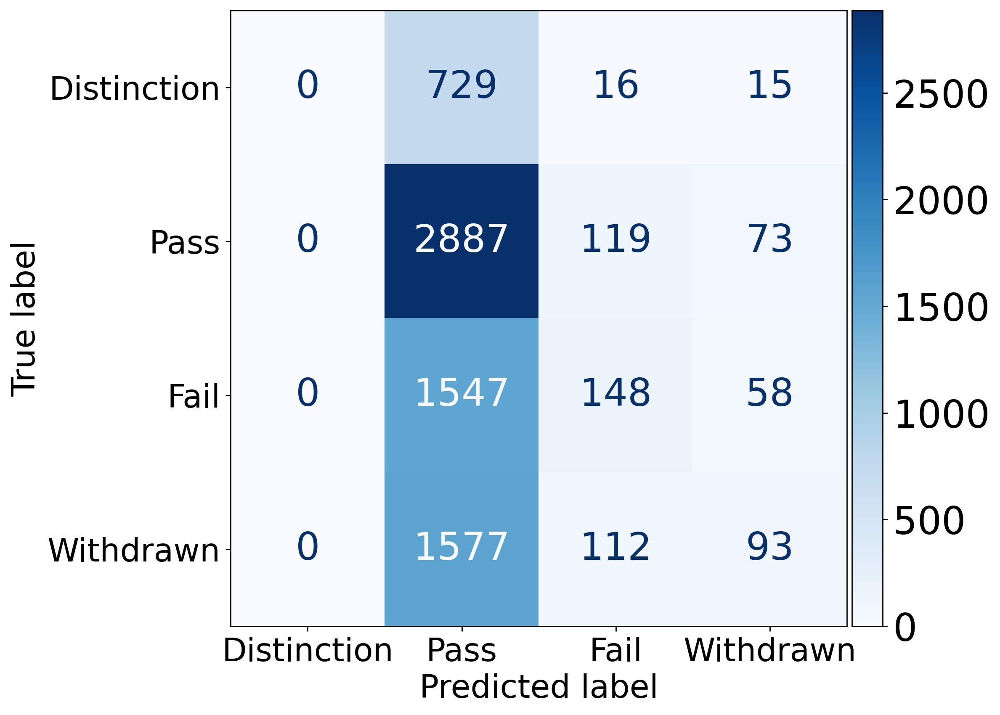

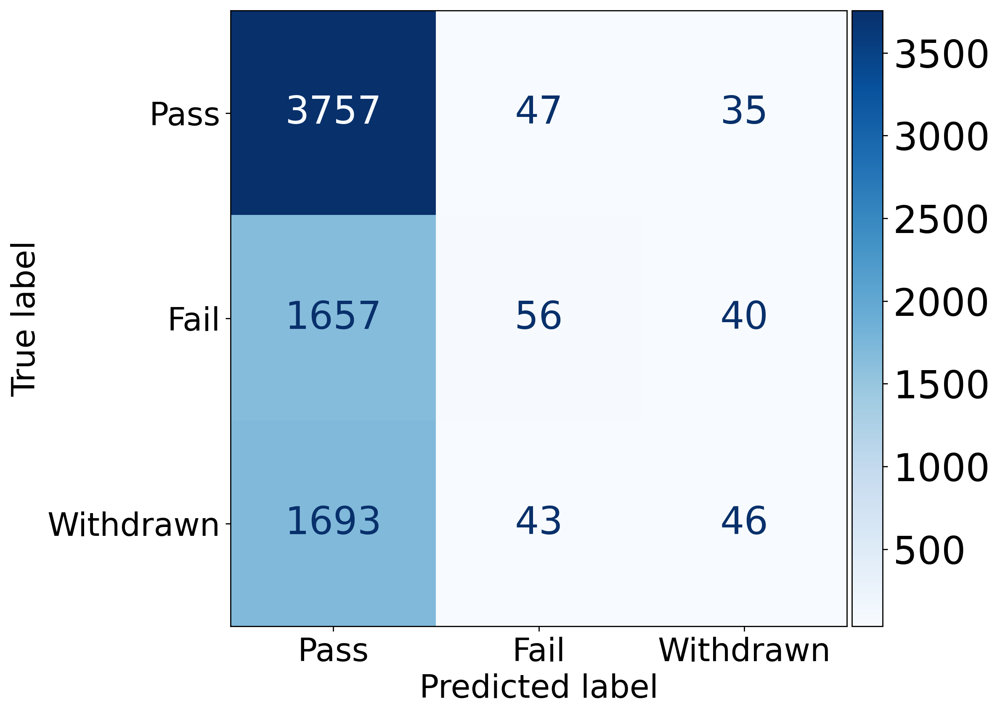

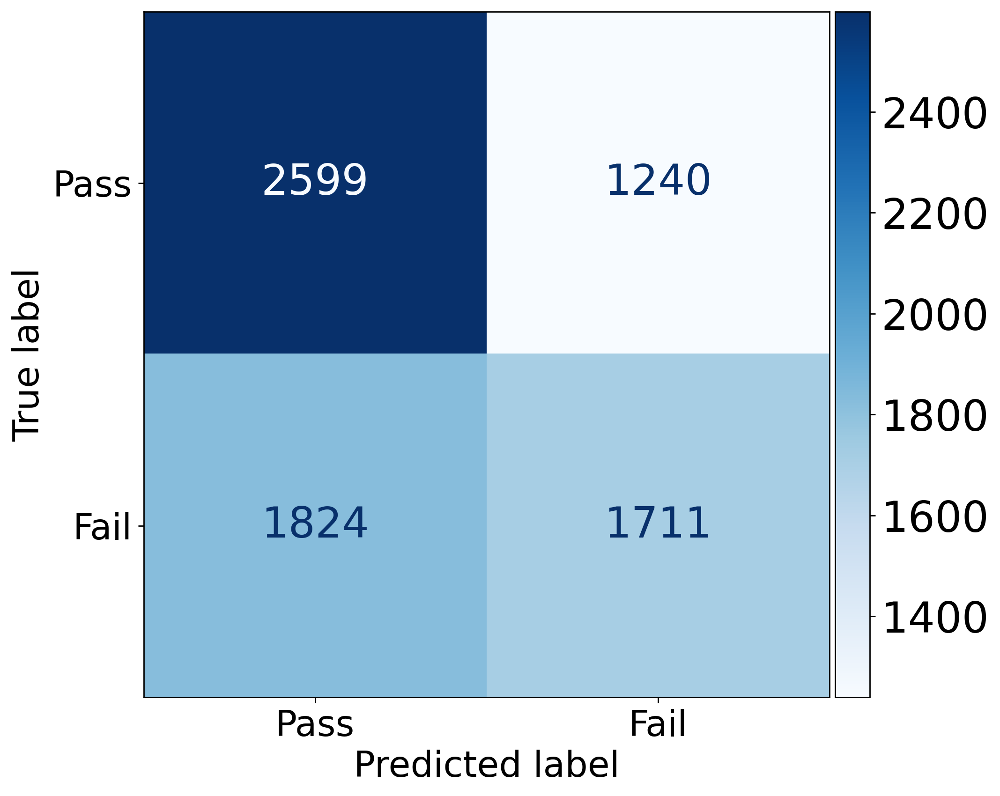

In [19]:
for n in range(4, 1, -1):
    reducedDF, labels = reduceYLables(demographic_dataframes[0], n, True)
    plotCm(reducedDF, classifiers[0], labels)

---

### 6.2. Experiment 2: VLE Interaction Features <a class="anchor" id="exp2"></a>

In [20]:
interactions_dataframes = getDFsWithSubFeatures(dataframes, vle_interactions_features)

In [21]:
interactionsClfComparer = ClfComparer(interactions_dataframes, classifiers)

**Vorhersage aller 4 Klassen:**

In [22]:
interactionsClfComparer.compareClassifiers(4)

100%|█████████████████████████████████████████| 101/101 [36:24<00:00, 21.63s/it]


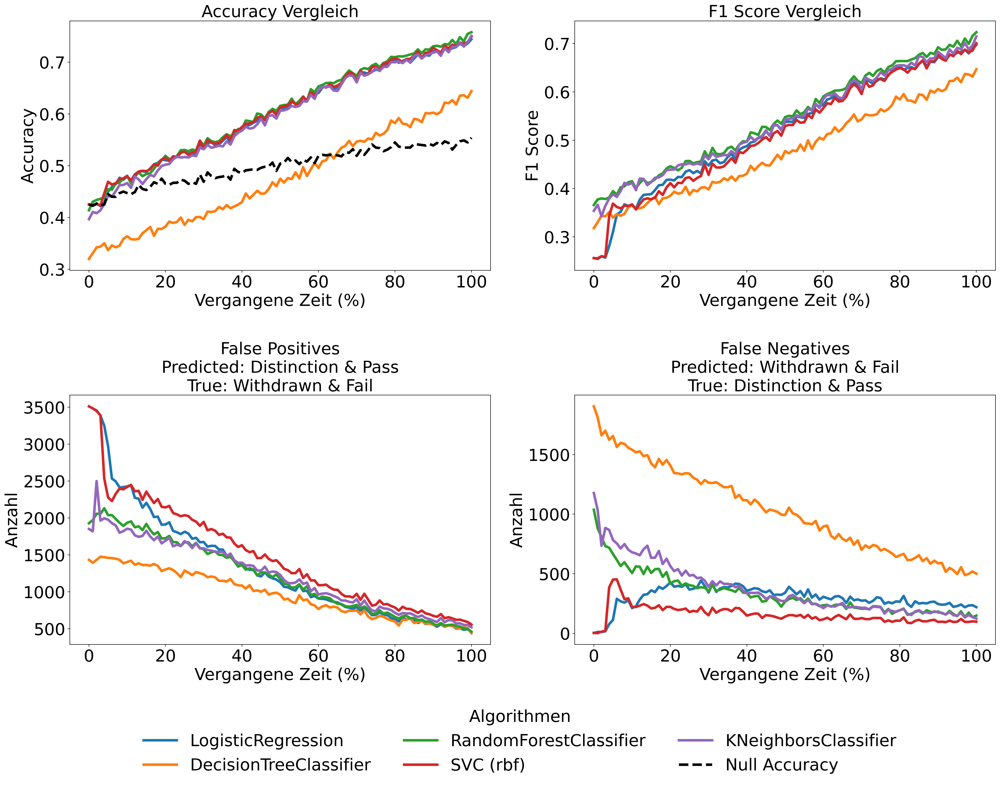

In [23]:
interactionsClfComparer.plotResults()

**Kreuzvalidierung** nach **70%** eines Kurses: <br>
Der Random Forest und der KNN Klassifikator haben beide eine hohe Accuracy mit einer niedrigen Anzahl an False Positives.

In [24]:
crossValidate(interactions_dataframes[70], classifiers[2])

RandomForestClassifier :  0.678 0.007
[0.68013611 0.67715866 0.67460655 0.67545725 0.66638298 0.67191489
 0.69148936 0.68085106 0.67234043 0.6893617 ]


In [25]:
crossValidate(interactions_dataframes[70], classifiers[4])

KNeighborsClassifier :  0.657 0.007
[0.65589111 0.65674181 0.64440664 0.66269672 0.65446809 0.64808511
 0.66510638 0.66212766 0.65404255 0.66680851]


**Plotten der wichtigsten Merkmale** (Random Forest)**:**

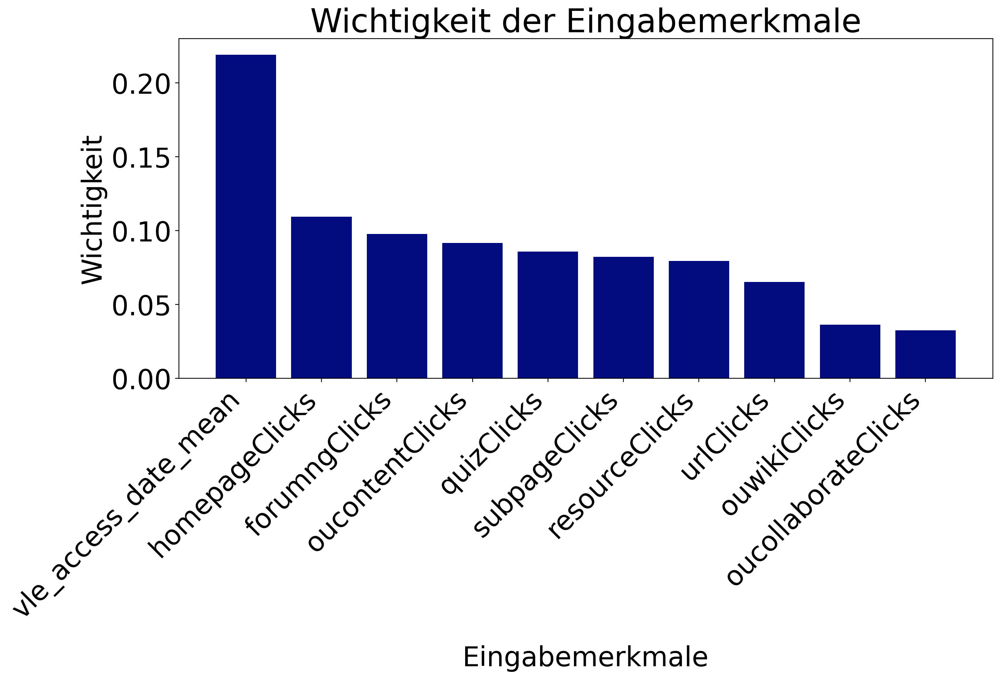

In [26]:
plotFeatureImportance(interactions_dataframes[70], classifiers[2])

**Vorhersage von 3 Klassen:** <br>

In [27]:
interactionsClfComparer.compareClassifiers(3)

100%|█████████████████████████████████████████| 101/101 [27:55<00:00, 16.59s/it]


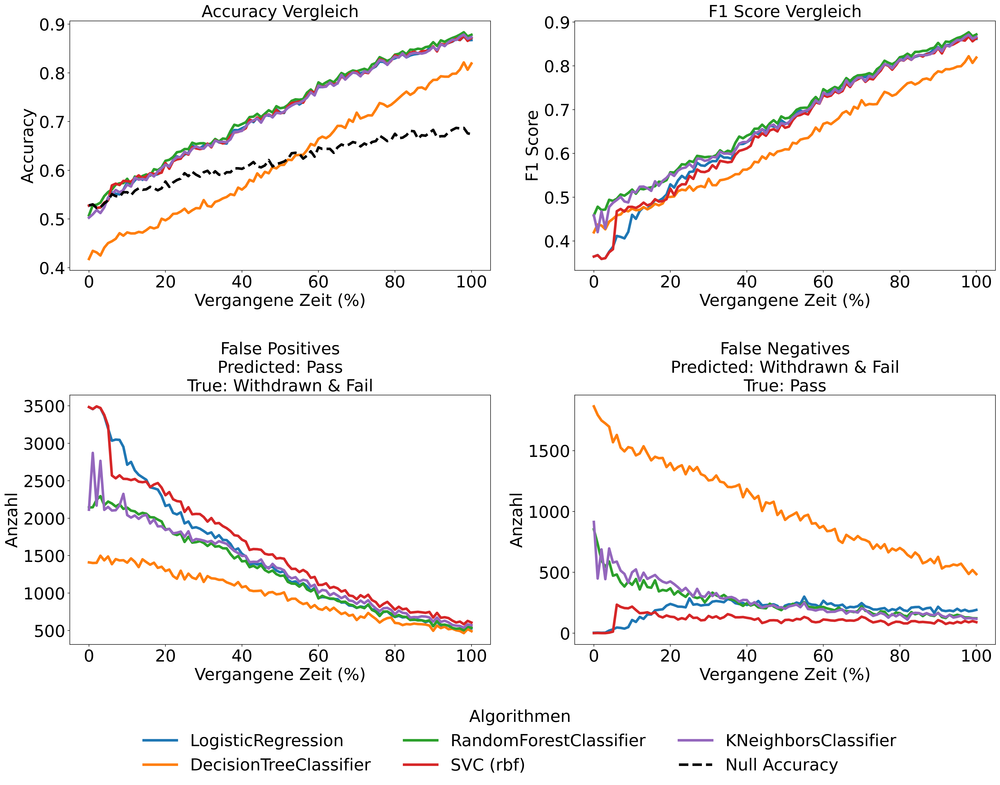

In [28]:
interactionsClfComparer.plotResults()

**Kreuzvalidierung** nach **70%** eines Kurses:

In [29]:
reducedDF = reduceYLables(interactions_dataframes[70], 3)
crossValidate(reducedDF, classifiers[2])

RandomForestClassifier :  0.805 0.006
[0.80986814 0.81582305 0.80476393 0.79923437 0.79148936 0.80425532
 0.80978723 0.80723404 0.80425532 0.80425532]


In [30]:
crossValidate(reducedDF, classifiers[4])

KNeighborsClassifier :  0.786 0.004
[0.78477244 0.79498086 0.78264568 0.78349638 0.78297872 0.78212766
 0.7893617  0.79106383 0.78510638 0.78340426]


**Plotten der wichtigsten Merkmale** (Random Forest)**:**

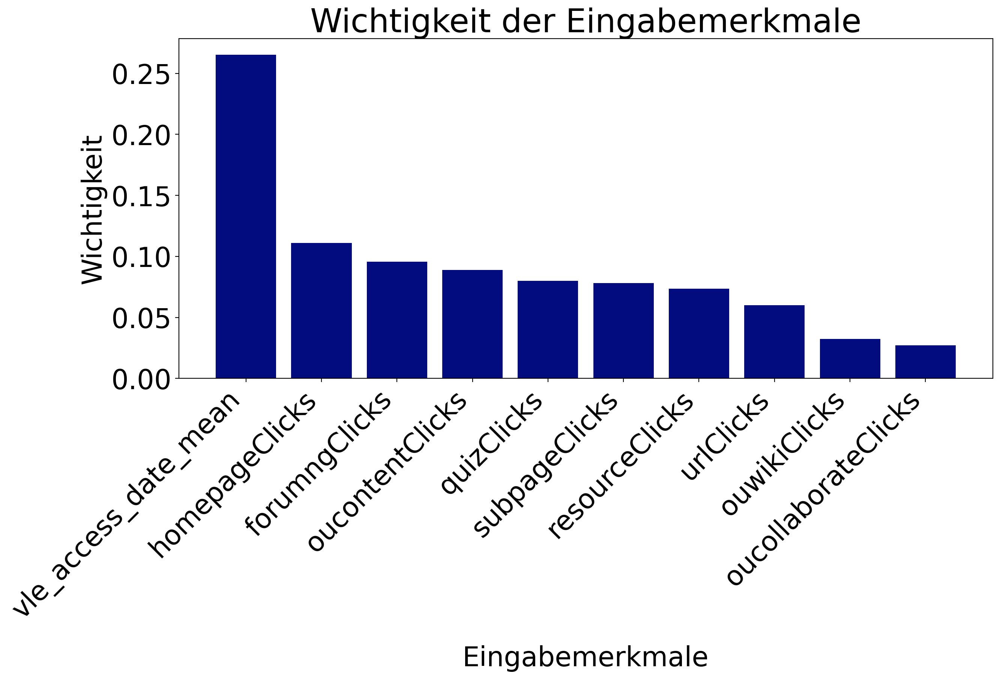

In [31]:
plotFeatureImportance(reducedDF, classifiers[2])

Die Vorhersage hat sich durch das Zusammenfügen der Klassen *Distintion* & *Pass* stark verbessert. Dies liegt daran, dass sich die Werte von den Instanzen die den zwei Klassen zugehören, bei dem wichtigsten Merkmal (*vle_access_date_mean*) kaum unterscheiden:

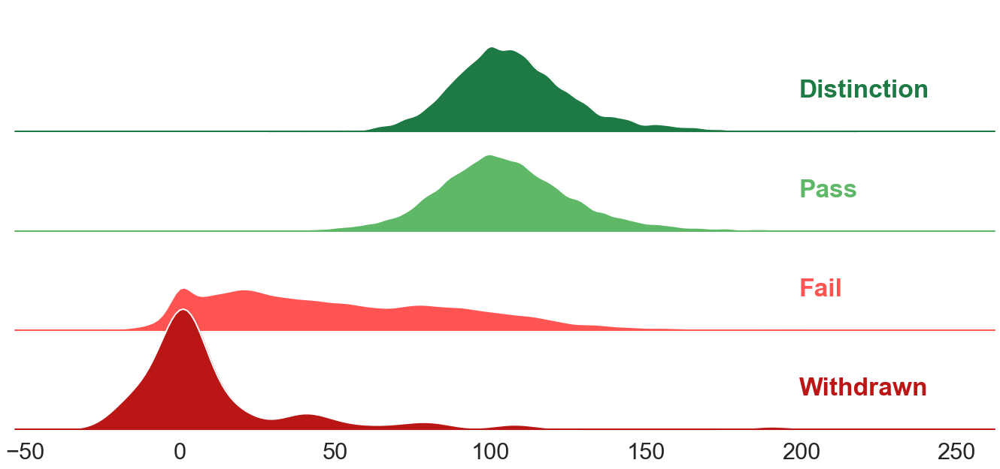

In [32]:
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)}, font_scale=2.8)

# Define and use a simple function to label the plot in axes coordinates
def label(x, color, label):
    ax = plt.gca()
    ax.text(0.8, .35, label, fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes, fontsize='medium')

# Initialize the FacetGrid object
g = sns.FacetGrid(dataframes[100], row="final_result", hue="final_result", aspect=8, height=2.6, palette=['#1d7a44', '#5fb868', '#ff5452', '#ba1616'],
                 row_order=['Distinction', 'Pass', 'Fail', 'Withdrawn'],
                 hue_order=['Distinction', 'Pass', 'Fail', 'Withdrawn'])

# Draw the densities in a few steps
g.map(sns.kdeplot, "vle_access_date_mean", bw_adjust=.5, clip_on=False, fill=True, alpha=1, linewidth=1.5)
g.map(sns.kdeplot, "vle_access_date_mean", clip_on=False, color="w", lw=2, bw_adjust=.5)

# passing color=None to refline() uses the hue mapping
g.refline(y=-0.0001, linewidth=2, linestyle="-", color=None, clip_on=False)

g.map(label, "vle_access_date_mean")

# Set the subplots to overlap
g.figure.subplots_adjust(hspace=-.25)

# Remove axes details that don't play well with overlap
g.set_titles("")
g.set(yticks=[], ylabel="")
g.set(xlabel="")
g.despine(bottom=True, left=True)

plt.show()

resetMatplotLib()

**Vorhersage von nur 2 Klassen:**

In [33]:
interactionsClfComparer.compareClassifiers(2)

100%|█████████████████████████████████████████| 101/101 [23:20<00:00, 13.86s/it]


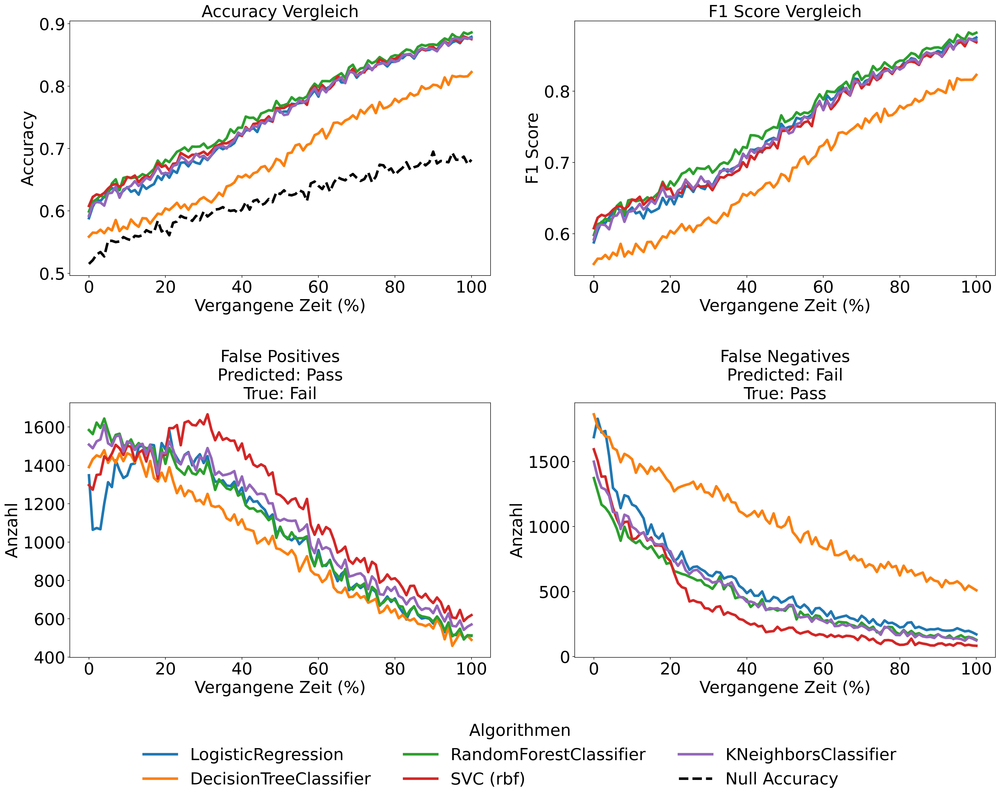

In [34]:
interactionsClfComparer.plotResults()

**Kreuzvalidierung** nach **70%** eines Kurses:

In [35]:
reducedDF = reduceYLables(interactions_dataframes[70], 2)
crossValidate(reducedDF, classifiers[2])

RandomForestClassifier :  0.829 0.004
[0.82688218 0.83411314 0.82347937 0.82390472 0.82212766 0.8293617
 0.83404255 0.83191489 0.82851064 0.83191489]


**Plotten der wichtigsten Merkmale** (Random Forest)**:**

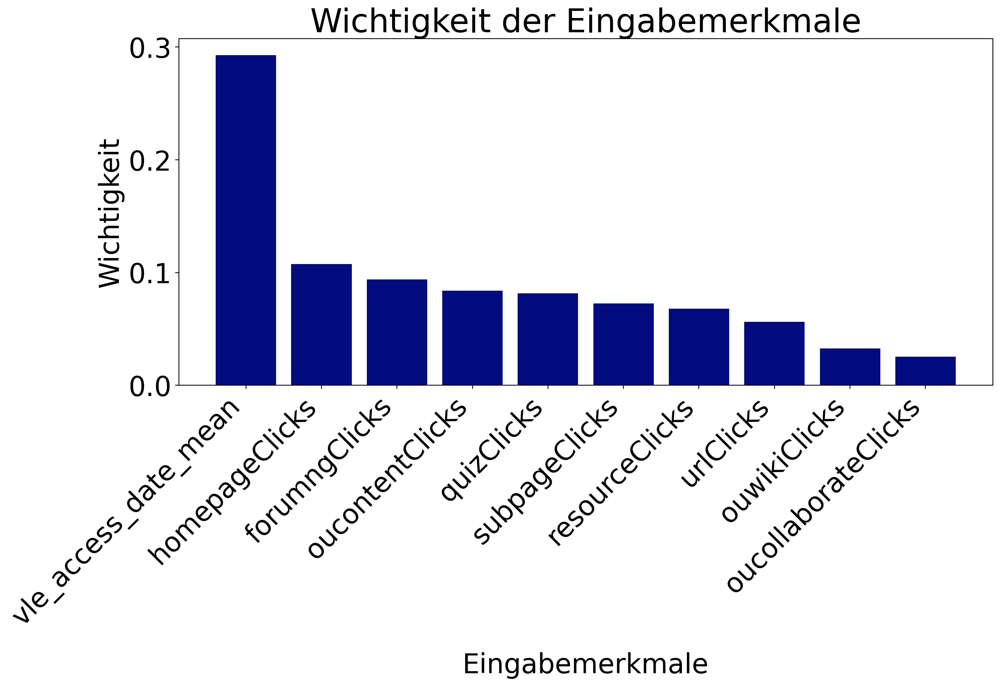

In [36]:
plotFeatureImportance(reducedDF, classifiers[2])

---

### 6.3. Experiment 3: Assessment Features <a class="anchor" id="exp3"></a>

In [37]:
assessment_dataframes = getDFsWithSubFeatures(dataframes, assessments_features)

In [38]:
assessmentClfComparer = ClfComparer(assessment_dataframes, classifiers)

**Vorhersage aller 4 Klassen:**

In [39]:
assessmentClfComparer.compareClassifiers(4)

100%|█████████████████████████████████████████| 101/101 [20:19<00:00, 12.08s/it]


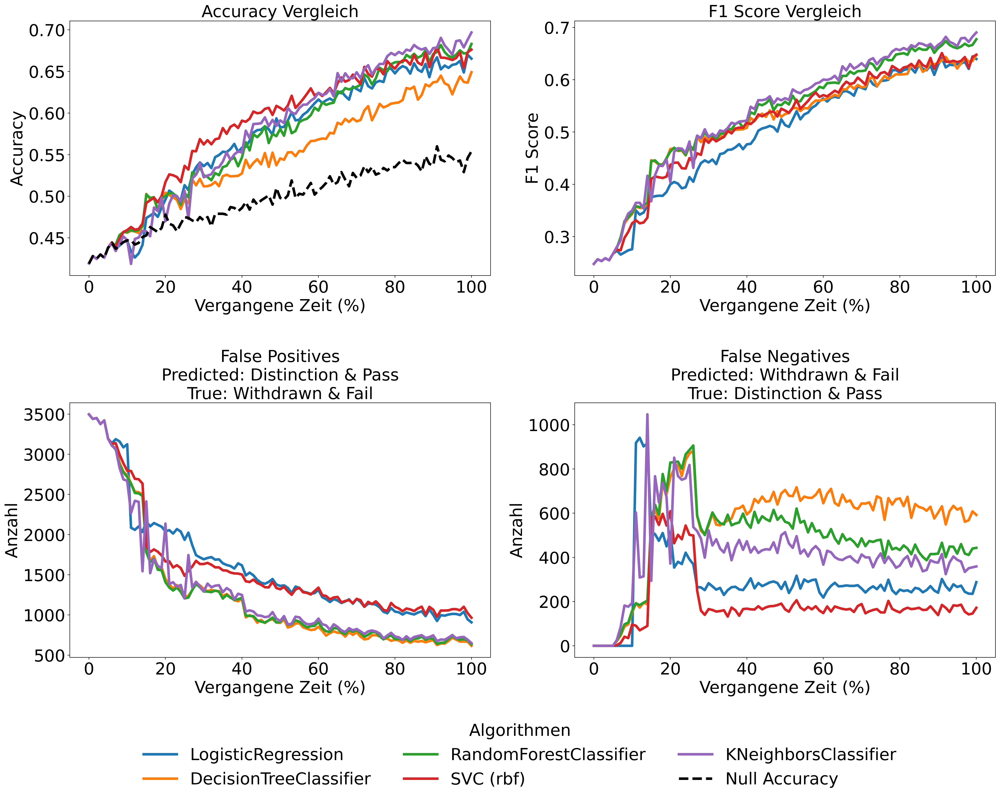

In [40]:
assessmentClfComparer.plotResults()

**Kreuzvalidierung** nach **70%** eines Kurses mit allen Klassifikatoren, da alle sehr nahe beieinander sind:

In [41]:
for clf in classifiers:
    crossValidate(assessment_dataframes[70], clf)

LogisticRegression :  0.629 0.009
[0.63419821 0.6299447  0.63845172 0.63887707 0.61617021 0.6212766
 0.62638298 0.61957447 0.6212766  0.64382979]
DecisionTreeClassifier :  0.591 0.008
[0.60697575 0.59634198 0.59123777 0.58400681 0.58510638 0.59957447
 0.58170213 0.58425532 0.58595745 0.59021277]
RandomForestClassifier :  0.638 0.006
[0.64568269 0.63972778 0.64355593 0.63930242 0.64       0.63617021
 0.63702128 0.6306383  0.62595745 0.64212766]
SVC :  0.642 0.011
[0.64695874 0.63675032 0.65036155 0.65291365 0.62510638 0.63787234
 0.63574468 0.62893617 0.64042553 0.66170213]
KNeighborsClassifier :  0.646 0.006
[0.65461506 0.64440664 0.64610804 0.64483199 0.64212766 0.64595745
 0.63531915 0.65446809 0.63617021 0.65276596]


**Plotten der wichtigsten Merkmale** (Random Forest)**:**

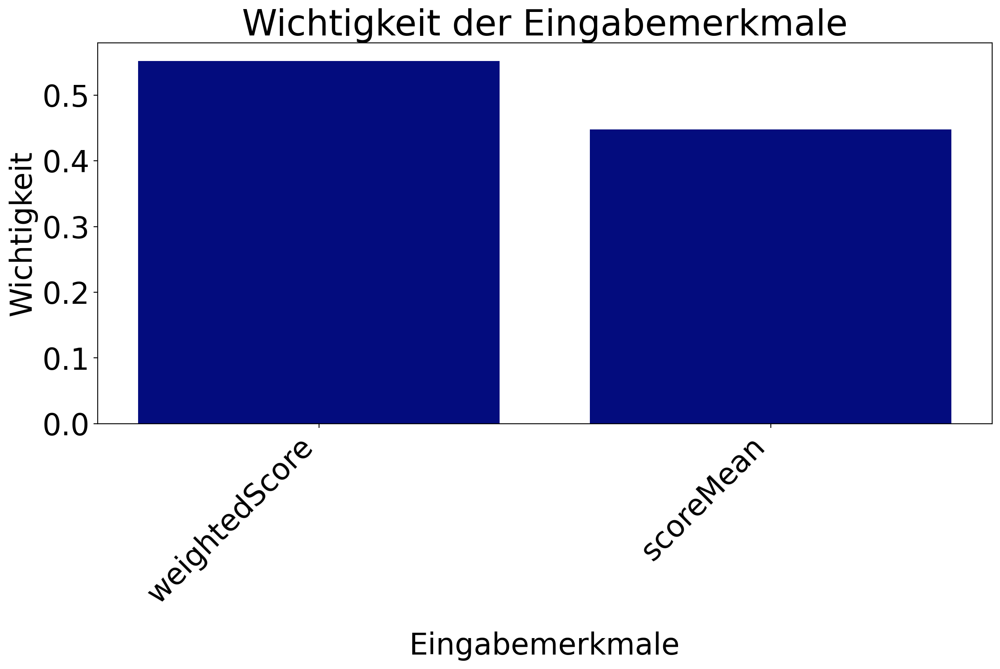

In [42]:
plotFeatureImportance(assessment_dataframes[70], classifiers[2])

**Vorhersage von 3 Klassen:**

In [43]:
assessmentClfComparer.compareClassifiers(3)

100%|█████████████████████████████████████████| 101/101 [16:38<00:00,  9.88s/it]


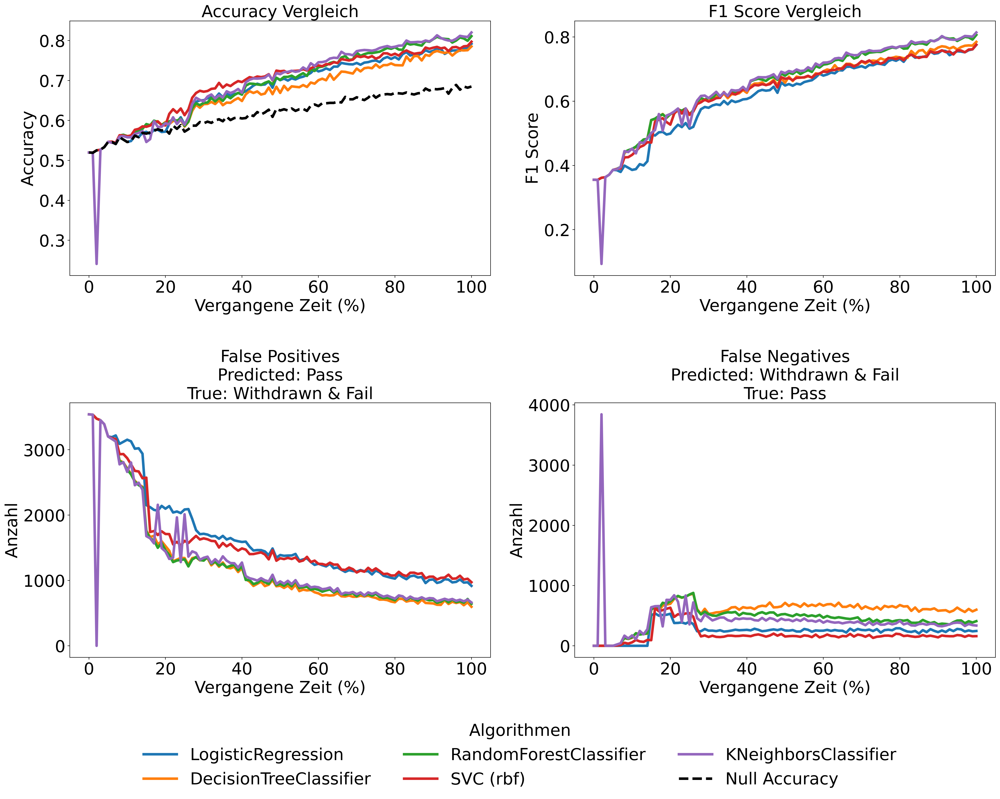

In [44]:
assessmentClfComparer.plotResults()

**Kreuzvalidierung** nach **70%** eines Kurses mit allen Klassifikatoren, da diese auch hier nahe beieinander liegen:

In [45]:
reducedDF = reduceYLables(assessment_dataframes[70], 3)

for clf in classifiers:
    crossValidate(reducedDF, clf)

LogisticRegression :  0.743 0.007
[0.7460655  0.75202042 0.75116972 0.74946831 0.73659574 0.73702128
 0.74085106 0.7293617  0.74255319 0.74297872]
DecisionTreeClassifier :  0.72 0.007
[0.72905147 0.72820077 0.73117822 0.71458954 0.71574468 0.72425532
 0.71404255 0.72       0.71191489 0.71361702]
RandomForestClassifier :  0.764 0.007
[0.77031051 0.77158656 0.77498937 0.75627393 0.76468085 0.76
 0.75404255 0.76638298 0.76255319 0.75744681]
SVC :  0.753 0.008
[0.75925138 0.75372182 0.76478094 0.76180349 0.74553191 0.74638298
 0.75148936 0.73659574 0.75702128 0.75744681]
KNeighborsClassifier :  0.768 0.007
[0.77328796 0.7669077  0.78009358 0.76350489 0.76170213 0.77021277
 0.75829787 0.77574468 0.76042553 0.76510638]


**Plotten der wichtigsten Merkmale** (Random Forest)**:**

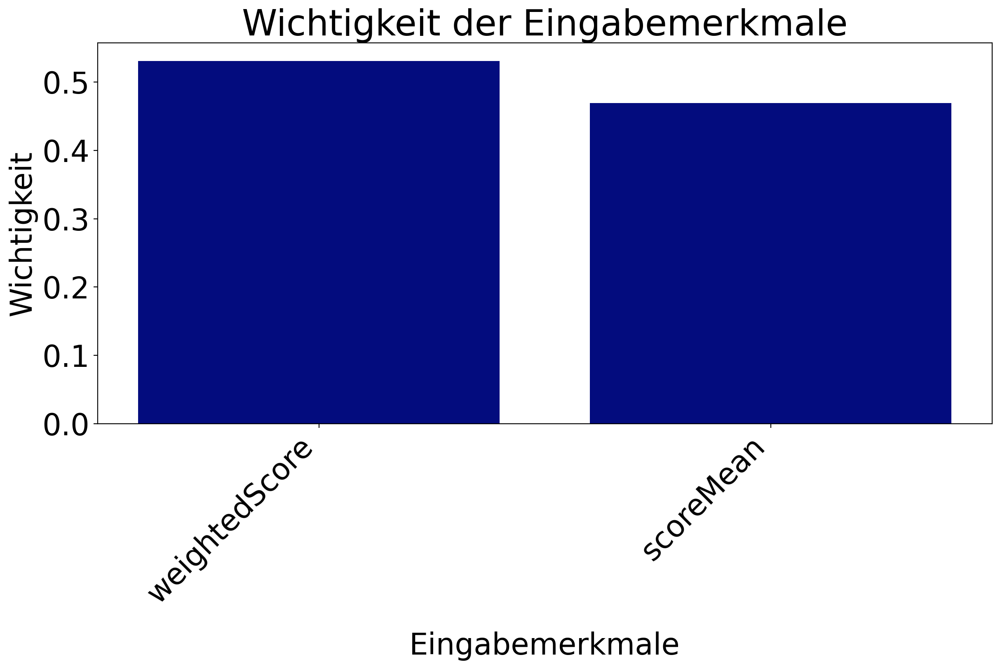

In [46]:
plotFeatureImportance(reducedDF, classifiers[2])

**Vorhersage von nur 2 Klassen:**

In [47]:
assessmentClfComparer.compareClassifiers(2)

100%|█████████████████████████████████████████| 101/101 [14:39<00:00,  8.71s/it]


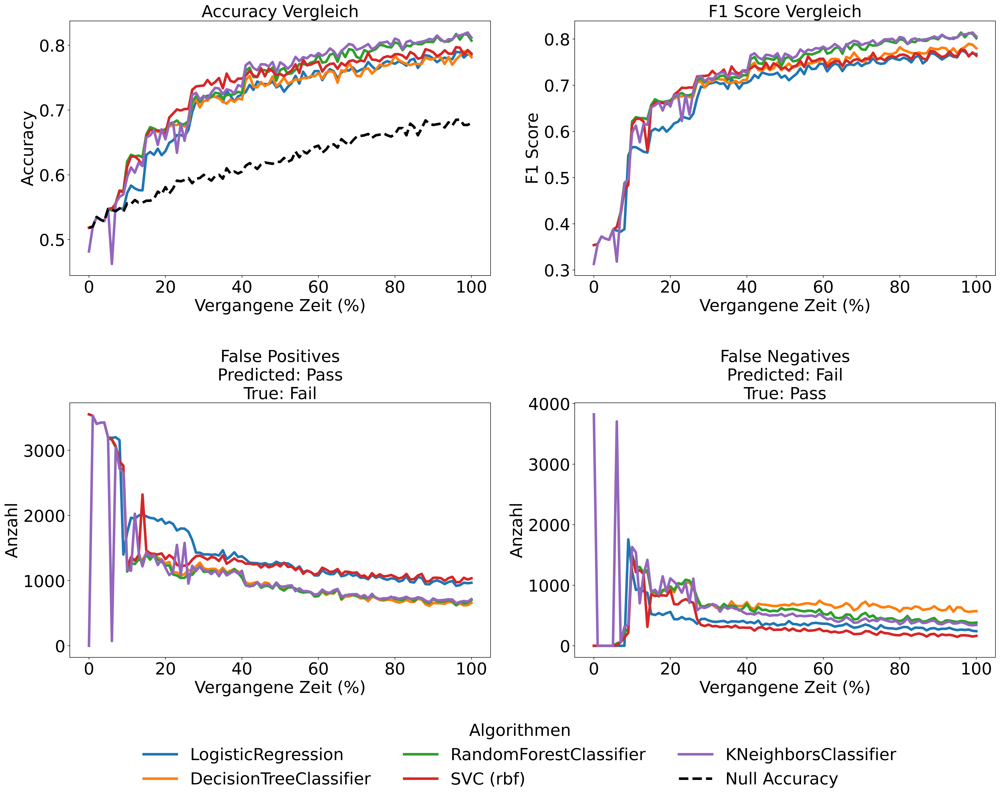

In [48]:
assessmentClfComparer.plotResults()

**Kreuzvalidierung:**

In [49]:
reducedDF = reduceYLables(assessment_dataframes[70], 2)
crossValidate(reducedDF, classifiers[3])

SVC :  0.774 0.008
[0.77711612 0.78136963 0.78051893 0.77881752 0.76851064 0.76468085
 0.77106383 0.75744681 0.77829787 0.7787234 ]


In [50]:
reducedDF = reduceYLables(assessment_dataframes[0], 2)
crossValidate(reducedDF, classifiers[4])

KNeighborsClassifier :  0.522 0.008
[0.51728814 0.50983051 0.52305085 0.52271186 0.53254237 0.53457627
 0.52628009 0.51983723 0.51746355 0.51237708]


In [51]:
reducedDF = reduceYLables(assessment_dataframes[50], 2)
crossValidate(reducedDF, classifiers[4])

KNeighborsClassifier :  0.764 0.007
[0.77539458 0.75637394 0.75475516 0.77215702 0.76244435 0.75718333
 0.77053824 0.76527722 0.75961149 0.76923077]


In [52]:
reducedDF = reduceYLables(assessment_dataframes[100], 2)
crossValidate(reducedDF, classifiers[4])

KNeighborsClassifier :  0.814 0.004
[0.82386868 0.81136263 0.81402574 0.81225033 0.81491345 0.81890812
 0.81136263 0.81580115 0.80958722 0.80781181]


**Plotten der wichtigsten Merkmale** (Random Forest)**:**

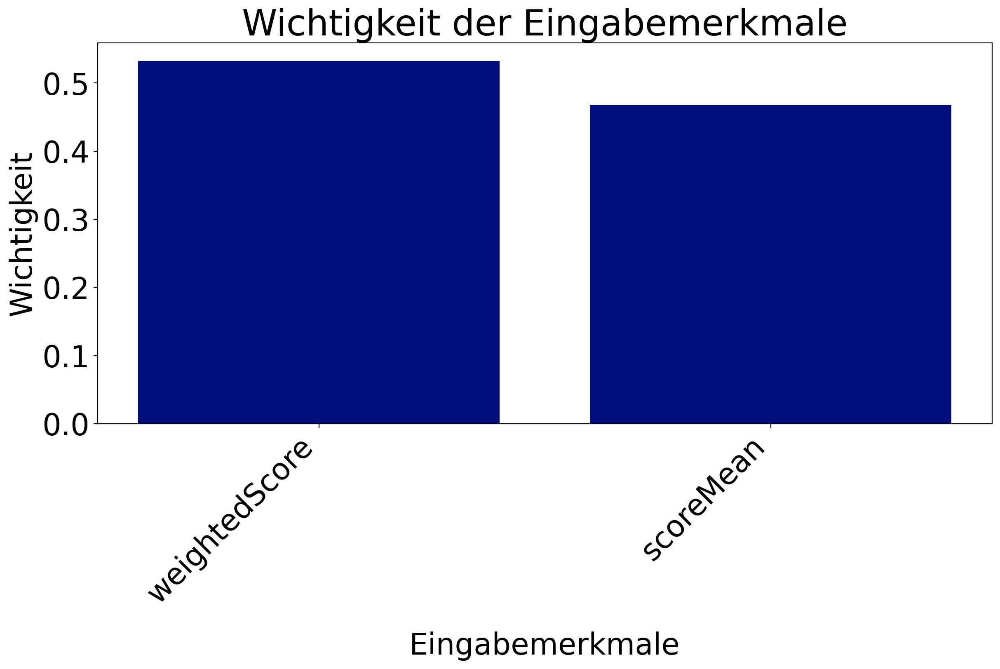

In [53]:
reducedDF = reduceYLables(assessment_dataframes[70], 2)
plotFeatureImportance(reducedDF, classifiers[2])

---

### 6.4. Experiment 4: All Features <a class="anchor" id="exp4"></a>

In [54]:
clfComparer = ClfComparer(dataframes, classifiers)

**Vorhersage aller 4 Klassen:**

In [55]:
clfComparer.compareClassifiers(4)

100%|███████████████████████████████████████| 101/101 [2:09:47<00:00, 77.10s/it]


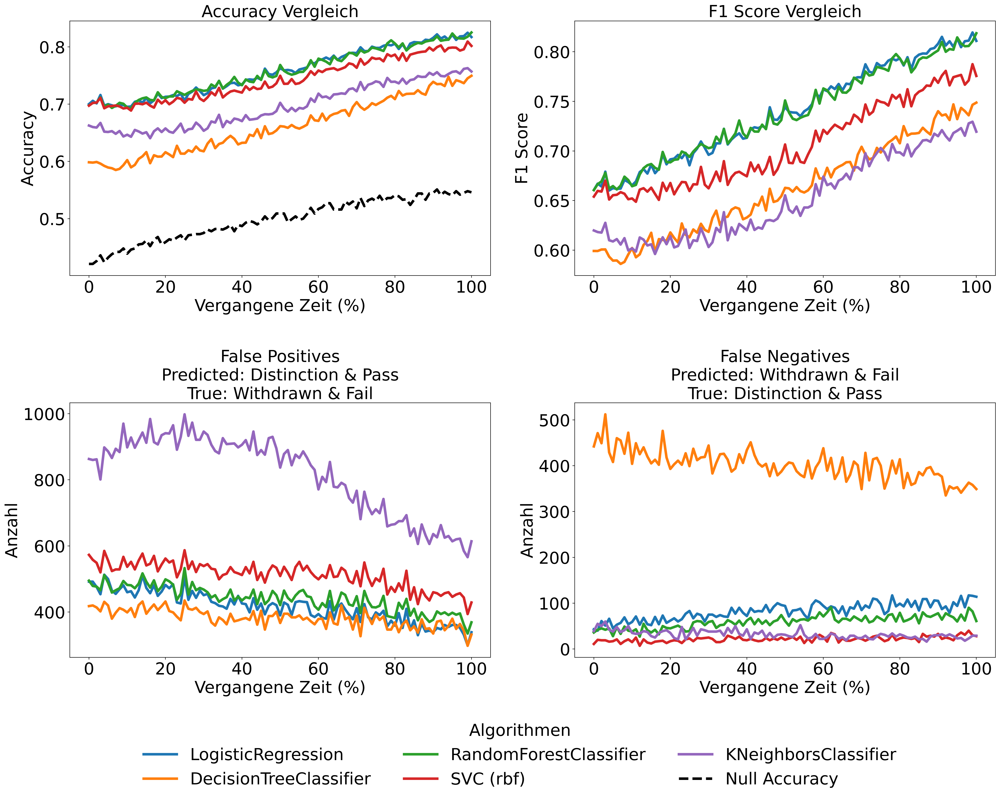

In [56]:
clfComparer.plotResults()

**Kreuzvalidierung** nach **70%** eines Kurses:

In [57]:
crossValidate(dataframes[70], classifiers[0])

/Users/Timothy/miniforge3/envs/BA2/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/Timothy/miniforge3/envs/BA2/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_

LogisticRegression :  0.766 0.007
[0.7677584  0.76137814 0.76222884 0.77328796 0.75191489 0.76510638
 0.76723404 0.76765957 0.76510638 0.77914894]


/Users/Timothy/miniforge3/envs/BA2/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [58]:
crossValidate(dataframes[70], classifiers[2])

RandomForestClassifier :  0.79 0.007
[0.7928541  0.77839217 0.78519779 0.79157805 0.77914894 0.78680851
 0.79319149 0.79829787 0.79021277 0.79957447]


**Plotten der wichtigsten Merkmale** (Random Forest)**:**

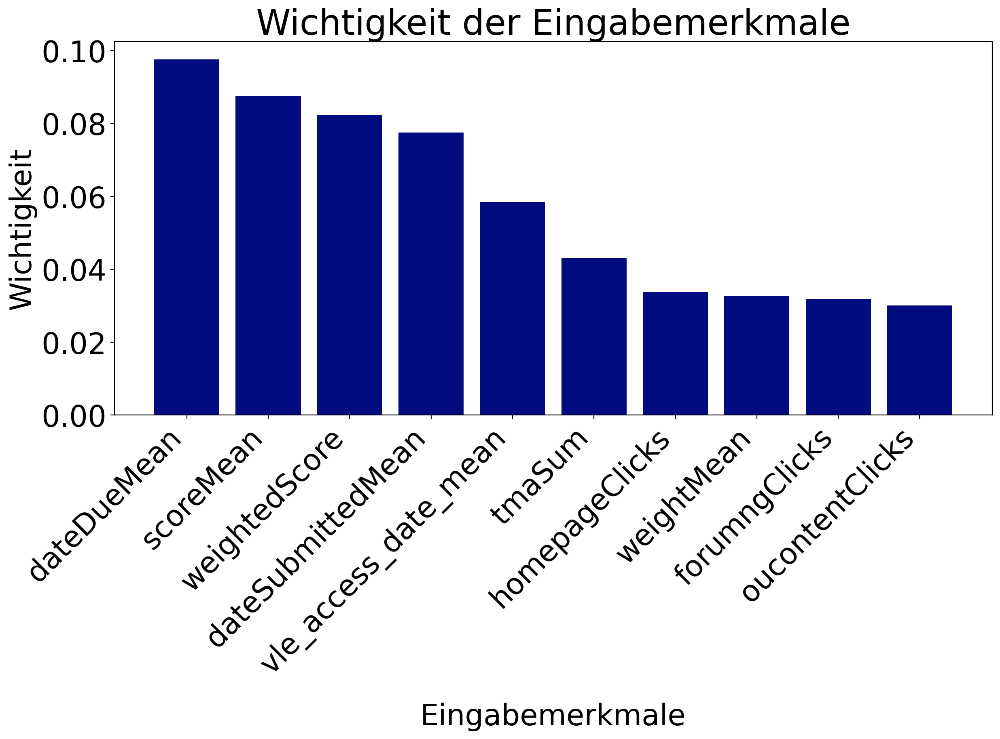

In [59]:
plotFeatureImportance(dataframes[70], classifiers[2])

**Vorhersage von 3 Klassen:**

In [60]:
clfComparer.compareClassifiers(3)

100%|██████████████████████████████████████| 101/101 [4:17:17<00:00, 152.85s/it]


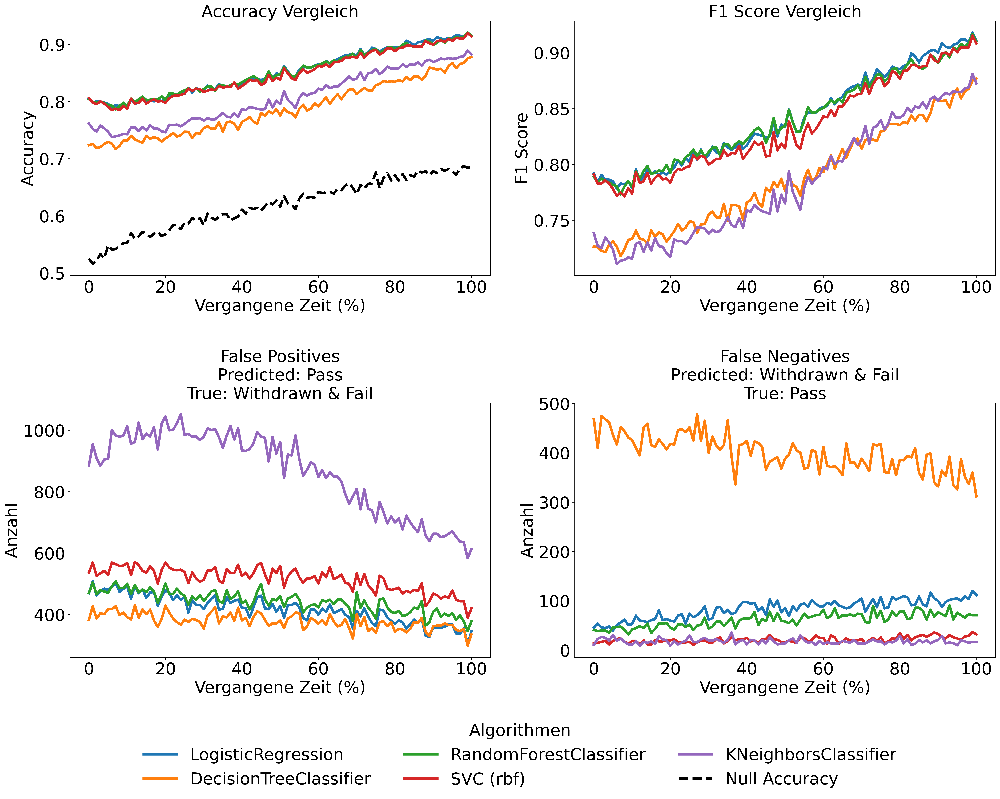

In [61]:
clfComparer.plotResults()

**Kreuzvalidierung:**

In [62]:
reducedDF = reduceYLables(dataframes[0], 3)
crossValidate(reducedDF, classifiers[2])

RandomForestClassifier :  0.797 0.007
[0.80033898 0.78474576 0.78915254 0.80271186 0.80440678 0.79932203
 0.80908783 0.79552391 0.78908104 0.795863  ]


In [63]:
reducedDF = reduceYLables(dataframes[70], 3)
crossValidate(reducedDF, classifiers[2])

RandomForestClassifier :  0.884 0.004
[0.88515525 0.88345385 0.88643131 0.87920034 0.87787234 0.88468085
 0.88765957 0.89319149 0.8812766  0.88297872]


**Plotten der wichtigsten Merkmale** (Random Forest)**:**

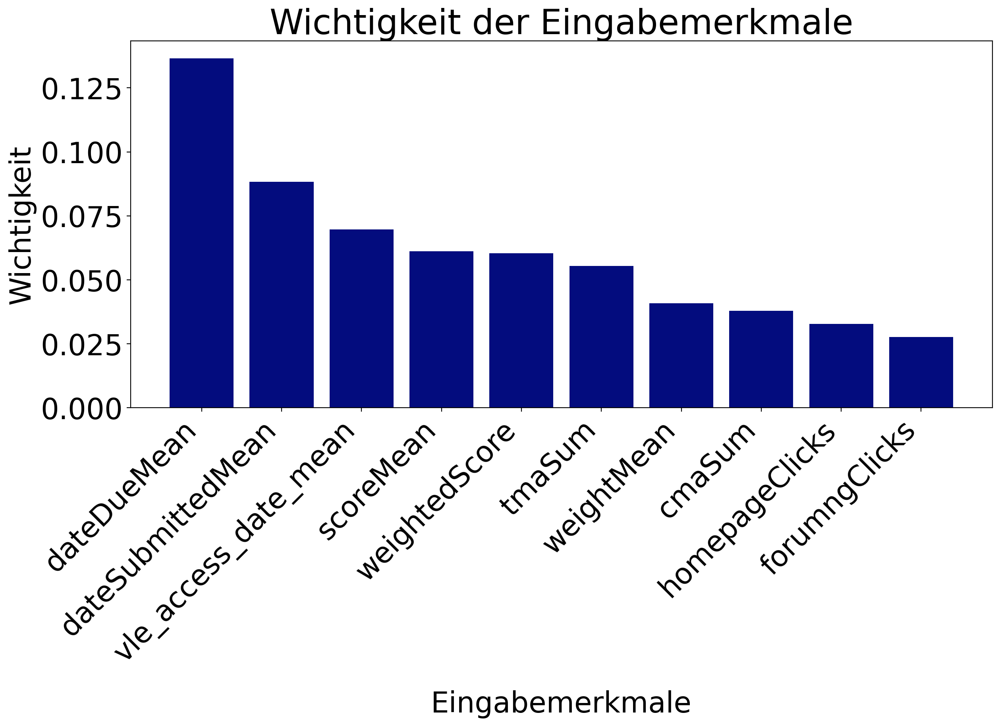

In [64]:
plotFeatureImportance(reducedDF, classifiers[2])

**Vorhersage von nur 2 Klassen:**

In [65]:
clfComparer.compareClassifiers(2)

100%|█████████████████████████████████████████| 101/101 [23:08<00:00, 13.74s/it]


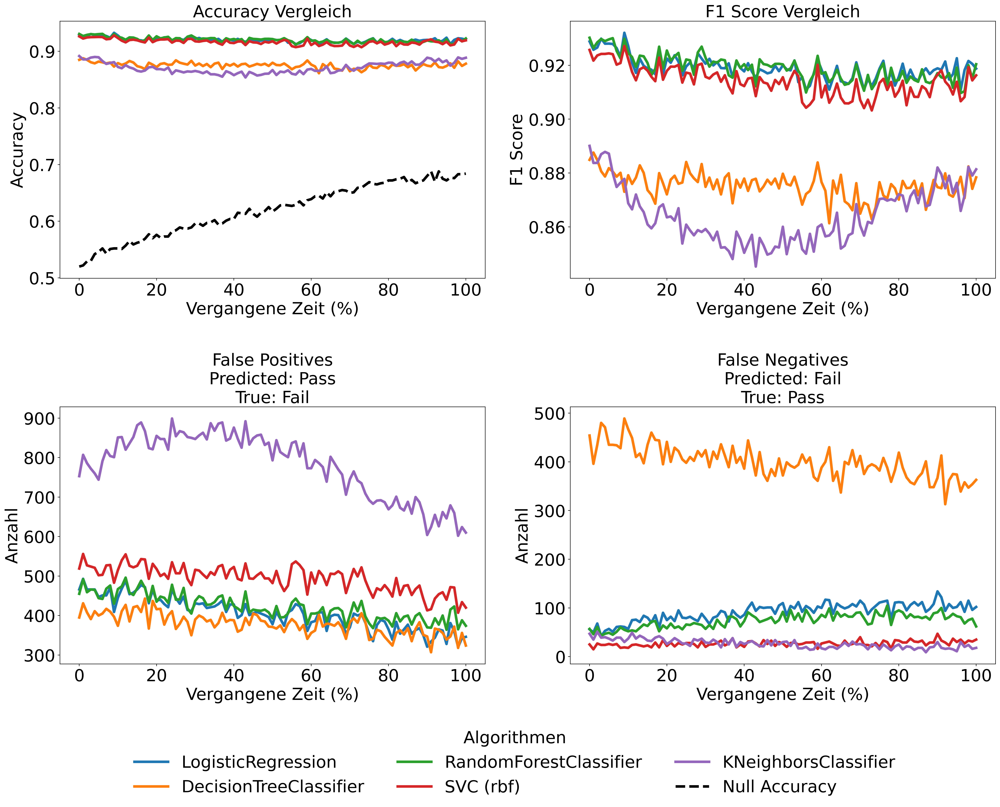

In [66]:
clfComparer.plotResults()

**Kreuzvalidierung** am **Anfang** eines Kurses mit allen Klassifikatoren:

In [67]:
reducedDF = reduceYLables(dataframes[0], 2)

for clf in classifiers:
    crossValidate(reducedDF, clf)

/Users/Timothy/miniforge3/envs/BA2/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/Timothy/miniforge3/envs/BA2/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_

LogisticRegression :  0.925 0.006
[0.91355932 0.92711864 0.91898305 0.93389831 0.92813559 0.92271186
 0.92573754 0.93014581 0.93082401 0.92336385]
DecisionTreeClassifier :  0.883 0.004
[0.88169492 0.89084746 0.88169492 0.88372881 0.87932203 0.8779661
 0.88402848 0.8809766  0.88877586 0.88572397]
RandomForestClassifier :  0.93 0.004
[0.92       0.92983051 0.92440678 0.93661017 0.93050847 0.92847458
 0.9318413  0.9328586  0.93353679 0.92912852]
SVC :  0.915 0.004
[0.90677966 0.91694915 0.90813559 0.92       0.9159322  0.91220339
 0.91658189 0.91827738 0.92031197 0.91793828]
KNeighborsClassifier :  0.898 0.005
[0.88949153 0.89864407 0.89016949 0.90440678 0.89728814 0.89661017
 0.90437436 0.89962699 0.90437436 0.89996609]


**Kreuzvalidierung** nach **70%** eines Kurses mit allen Klassifikatoren:

In [68]:
reducedDF = reduceYLables(dataframes[70], 2)

for clf in classifiers:
    crossValidate(reducedDF, clf)

/Users/Timothy/miniforge3/envs/BA2/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/Timothy/miniforge3/envs/BA2/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_

LogisticRegression :  0.909 0.003
[0.9072735  0.91280306 0.90429604 0.9089749  0.9093617  0.9106383
 0.90851064 0.91489362 0.91191489 0.90340426]
DecisionTreeClassifier :  0.872 0.005
[0.87239473 0.86431306 0.87579753 0.86941727 0.87659574 0.8787234
 0.87276596 0.87787234 0.86851064 0.86425532]
RandomForestClassifier :  0.918 0.003
[0.91833262 0.91748192 0.91748192 0.91705657 0.91404255 0.9212766
 0.91617021 0.92468085 0.92       0.91276596]
SVC :  0.891 0.003
[0.88813271 0.89323692 0.88898341 0.88728201 0.89319149 0.89446809
 0.8893617  0.89489362 0.89234043 0.89191489]
KNeighborsClassifier :  0.855 0.005
[0.85027648 0.86346236 0.85070183 0.85197788 0.85574468 0.85574468
 0.85531915 0.86510638 0.84808511 0.85617021]


**Plotten der Confusion Matrix des Random Forests:** <br>
Zum Start eines Kurses.

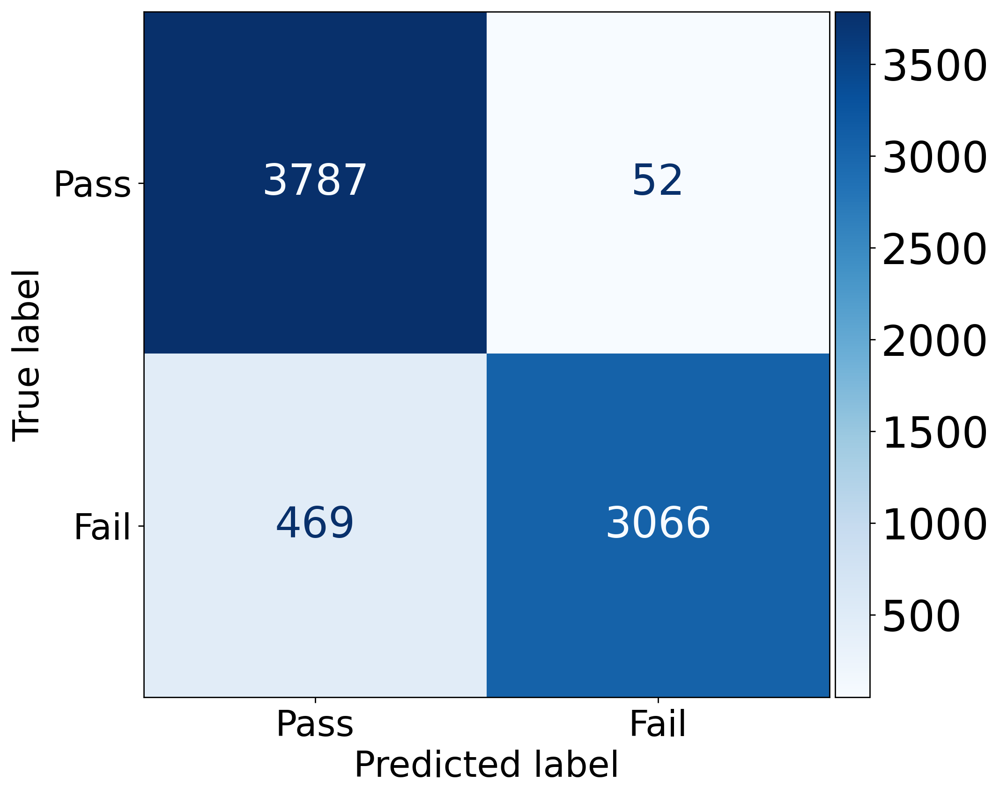

In [70]:
reducedDF, labels = reduceYLables(dataframes[0], 2, True)
plotCm(reducedDF, classifiers[2], labels)

Wie zu erkennen, sinkt die Anzahl an Studierenden mit dem Wert des Zielmerkmals *Fail*. Dies liegt an Studierenden, die einen Kurs vorzeitig beenden.

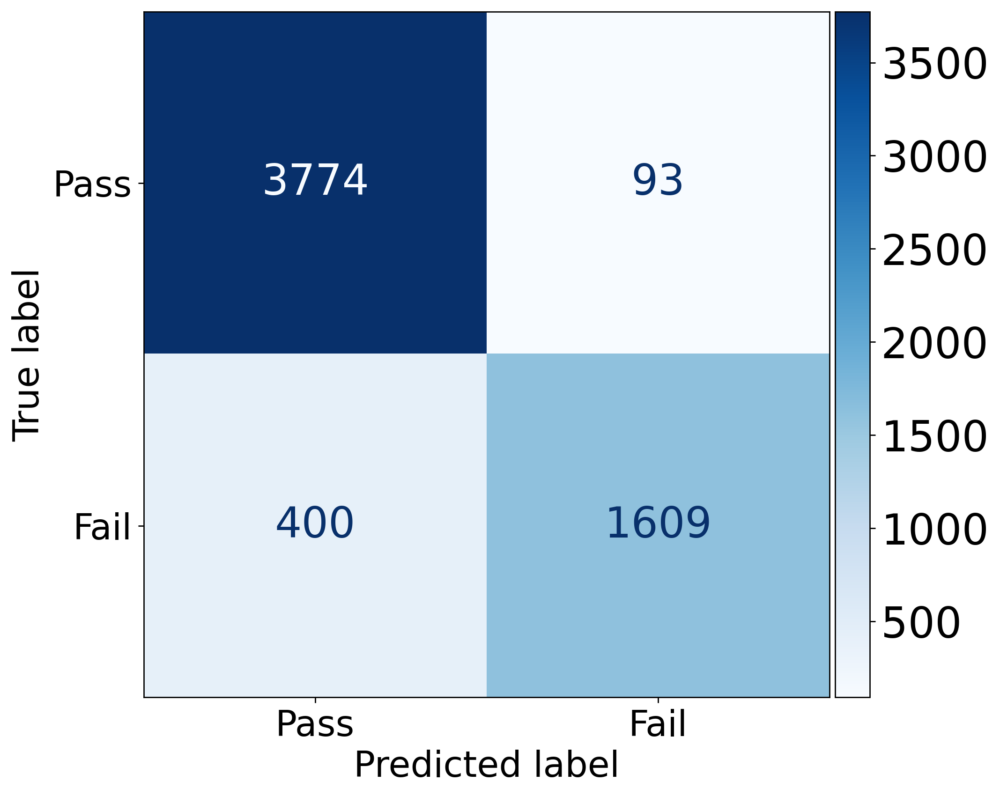

In [71]:
reducedDF, labels = reduceYLables(dataframes[70], 2, True)
plotCm(reducedDF, classifiers[2], labels)

**Plotten der wichtigsten Merkmale des Random Forests am Anfang und nach 70% eines Kurses:**

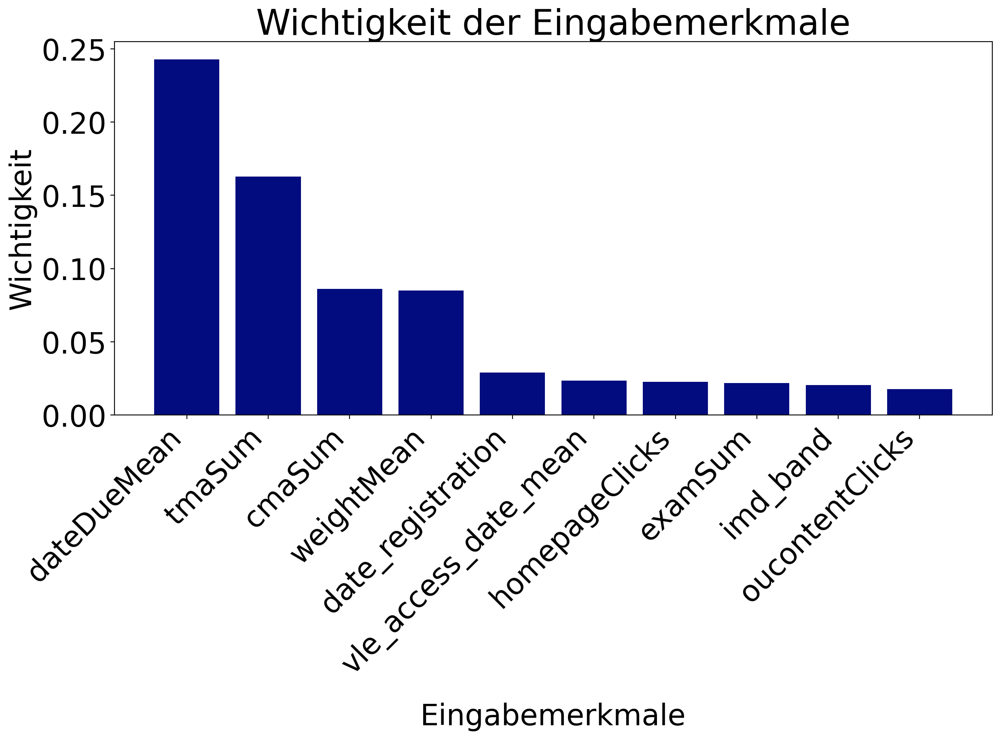

In [72]:
reducedDF = reduceYLables(dataframes[0], 2)
plotFeatureImportance(reducedDF, classifiers[2])

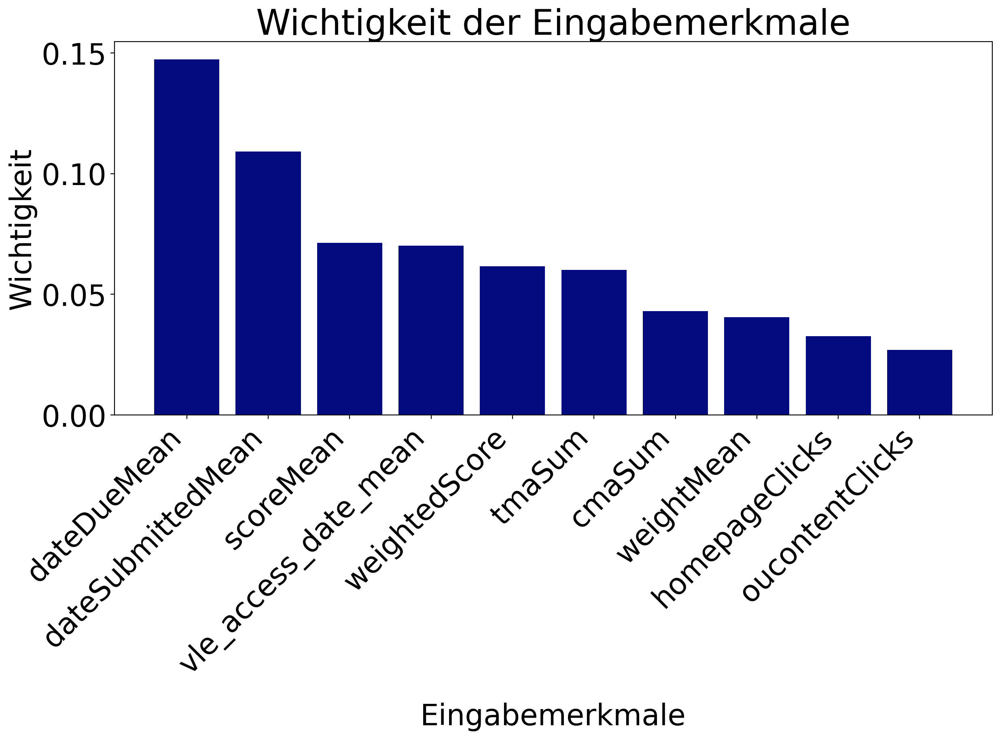

In [73]:
reducedDF = reduceYLables(dataframes[70], 2)
plotFeatureImportance(reducedDF, classifiers[2])

## 7. Optimierung <a class="anchor" id="opt"></a>

In [74]:
from sklearn.model_selection import RandomizedSearchCV
from sklearn.utils import shuffle

In [75]:
train_dataframes = []
test_dataframes = []

for df in dataframes:
    df = shuffle(df)
    
    classDict = { 'Distinction': 'Pass', 'Pass': 'Pass', 'Withdrawn': 'Fail', 'Fail': 'Fail' }
    df['final_result'] = df['final_result'].apply(lambda x: classDict[x])
    
    train_dataframes.append(df.iloc[:len(df)//100*25,:])
    test_dataframes.append(df.iloc[len(df)//100*25:,:])

In [76]:
def getOptimizedParams(clf, grid, df):
    search = RandomizedSearchCV(clf, param_distributions=grid, scoring='accuracy', n_jobs=4, n_iter=10)
    
    numericDF = df.select_dtypes(include=np.number)
    X = numericDF.values
    y = df['final_result']
    
    result = search.fit(X, y)
    
    print('Best Score: %s' % result.best_score_)
    print('Best Hyperparameters: %s' % result.best_params_)
    
    return result.best_params_

### Random Forest

In [77]:
rfc = RandomForestClassifier()

rfcGrid = dict()

rfcGrid['bootstrap'] = [True, False]
rfcGrid['max_depth'] = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 120, 150, None]
rfcGrid['max_features'] = ['auto', 'sqrt', 'log2']
rfcGrid['min_samples_leaf'] = [1, 2, 4]
rfcGrid['min_samples_split'] = [2, 5, 8, 10, 15]
rfcGrid['n_estimators'] = [200, 400, 600, 800, 1000, 1200, 1400, 1600, 1800, 2000]

rfcParams = getOptimizedParams(rfc, rfcGrid, train_dataframes[70])

Best Score: 0.9193191489361702
Best Hyperparameters: {'n_estimators': 200, 'min_samples_split': 10, 'min_samples_leaf': 2, 'max_features': 'auto', 'max_depth': 120, 'bootstrap': False}


### Logistic Regression

In [78]:
lr = LogisticRegression(max_iter=1000)

lrGrid = dict()
lrGrid['solver'] = ['newton-cg', 'lbfgs', 'liblinear']
lrGrid['penalty'] = ['l1', 'l2', 'elasticnet']
lrGrid['C'] = [1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1, 10, 100]

lrParams = getOptimizedParams(lr, lrGrid, train_dataframes[70])

/Users/Timothy/miniforge3/envs/BA2/lib/python3.8/site-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
40 fits failed out of a total of 50.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
15 fits failed with the following error:
Traceback (most recent call last):
  File "/Users/Timothy/miniforge3/envs/BA2/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 681, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/Timothy/miniforge3/envs/BA2/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py", line 1461, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/Users/Timothy/miniforge3/envs/BA2/lib/python3.8/site-packages/sklearn/l

Best Score: 0.9191489361702129
Best Hyperparameters: {'solver': 'liblinear', 'penalty': 'l1', 'C': 100}


### Entscheidungsbaum

In [79]:
dt = DecisionTreeClassifier()

dtGrid = dict()

dtGrid['criterion'] = ['gini', 'entropy']
dtGrid['max_depth'] = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 120, 150, None]
dtGrid['max_features'] = ['auto', 'sqrt', 'log2']
dtGrid['min_samples_leaf'] = [1, 2, 4]
dtGrid['min_samples_split'] = [2, 5, 8, 10, 15]

dtParams = getOptimizedParams(dt, dtGrid, train_dataframes[70])

Best Score: 0.8805106382978722
Best Hyperparameters: {'min_samples_split': 10, 'min_samples_leaf': 2, 'max_features': 'auto', 'max_depth': 10, 'criterion': 'entropy'}


### Vergleich

In [80]:
import warnings 
warnings.filterwarnings("ignore")

In [81]:
optimizedClassifiers = [
    RandomForestClassifier(**rfcParams),
    LogisticRegression(**lrParams),
    DecisionTreeClassifier(**dtParams)
]

clfComparer = ClfComparer(test_dataframes, optimizedClassifiers)

In [82]:
clfComparer.compareClassifiers(2)

100%|█████████████████████████████████████████| 101/101 [31:47<00:00, 18.89s/it]


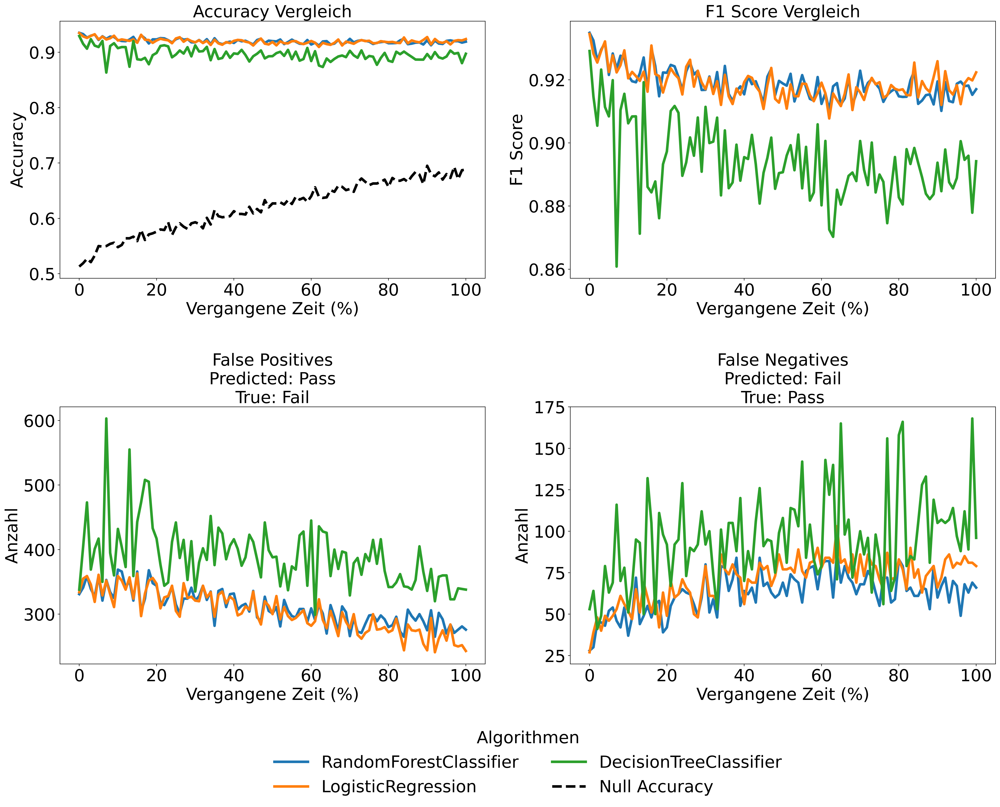

In [83]:
clfComparer.plotResults()

In [85]:
reducedDF = reduceYLables(test_dataframes[70], 2)

for clf in optimizedClassifiers:
    crossValidate(reducedDF, clf)

RandomForestClassifier :  0.917 0.006
[0.91094725 0.91605218 0.91094725 0.91094725 0.91378332 0.9279637
 0.91378332 0.92342598 0.9166194  0.92395006]
LogisticRegression :  0.915 0.005
[0.90754396 0.91151446 0.92285876 0.91094725 0.91605218 0.92399319
 0.91888826 0.91945547 0.90867839 0.91486947]
DecisionTreeClassifier :  0.893 0.007
[0.89449801 0.89903573 0.88712422 0.8825865  0.88088486 0.90470788
 0.89563244 0.89166194 0.90073738 0.89103292]
